### Cab Catchers
New York City (NYC) Taxi & Limousine Commission (TLC) keeps data from all its cabs, and it is freely available to download from its official website. You can access it here. Now, the TLC primarily keeps and manages data for 4 different types of vehicles:
* Yellow Taxi: Yellow Medallion Taxicabs
* Green Taxi: Street Hail Livery
* For-Hire Vehicles (FHVs)
* High Volume For-Hire Vehicle

Yellow and green taxi trip records include fields capturing pick-up and drop-off dates/times, pick-up and drop-off locations, trip distances, itemized fares, rate types, payment types, and driver-reported passenger counts. The data used in the attached datasets were collected and provided to the NYC Taxi and Limousine Commission (TLC) by technology providers authorized under the Taxicab & Livery Passenger Enhancement Programs (TPEP/LPEP).

In [1]:
# pyarrow library has parquet module that supports reading the PARQUET data into a DataFrame
import pyarrow.parquet as pq
import pandas as pd
import hvplot.pandas 
import glob
from pathlib import Path
import random

taxi+_zone_lookup.csv contains taxi zone data that could be used to map and obtain insights about taxi trip is specific zones

In [2]:
taxi_zone_df = pd.read_csv(Path('../Resources/taxi+_zone_lookup.csv'))

clean the data such that if any rows are blank, then remove the rows from the dataframe

In [3]:
taxi_zone_df.dropna(how='any', inplace=True)

In [4]:
# fhv_taxi_032023 = pd.DataFrame()
# fhv_trip = pq.read_table('./Resources/fhv_tripdata_2023-03.parquet')
# fhv_taxi_032023 = fhv_trip.to_pandas()
# display(fhv_taxi_032023.shape) 

In [5]:
#fhv_taxi_032023.to_csv('./Resources/fhv_taxi_032023.csv')

In [4]:
# read all the green taxi cab PARQUET data files from the Resources folder and hold them in a DataFrame
# this for loop will load all of 2022 data into the DataFrame
green_taxi_trips_df = pd.DataFrame()
for fname in glob.glob('../Resources/green_tripdata_2022*.parquet'):
    trips = pq.read_table(fname)
    trips = trips.to_pandas()
    green_taxi_trips_df = pd.concat([green_taxi_trips_df,trips],axis=0)
display(green_taxi_trips_df.shape)

(840402, 20)

In [5]:
# verify that the DataFrame
green_taxi_trips_df.head()

,VendorID,lpep_pickup_datetime,lpep_dropoff_datetime,store_and_fwd_flag,RatecodeID,PULocationID,DOLocationID,passenger_count,trip_distance,fare_amount,extra,mta_tax,tip_amount,tolls_amount,ehail_fee,improvement_surcharge,total_amount,payment_type,trip_type,congestion_surcharge
0,2,2022-01-01 00:14:21,2022-01-01 00:15:33,N,1.0,42,42,1.0,0.44,3.5,0.50,0.5,0.00,0.0,None,0.3,4.80,2.0,1.0,0.00
1,1,2022-01-01 00:20:55,2022-01-01 00:29:38,N,1.0,116,41,1.0,2.10,9.5,0.50,0.5,0.00,0.0,None,0.3,10.80,2.0,1.0,0.00
2,1,2022-01-01 00:57:02,2022-01-01 01:13:14,N,1.0,41,140,1.0,3.70,14.5,3.25,0.5,4.60,0.0,None,0.3,23.15,1.0,1.0,2.75
3,2,2022-01-01 00:07:42,2022-01-01 00:15:57,N,1.0,181,181,1.0,1.69,8.0,0.50,0.5,0.00,0.0,None,0.3,9.30,2.0,1.0,0.00
4,2,2022-01-01 00:07:50,2022-01-01 00:28:52,N,1.0,33,170,1.0,6.26,22.0,0.50,0.5,5.21,0.0,None,0.3,31.26,1.0,1.0,2.75


In [6]:
# drop the columns that are not required for analysis
green_taxi_trips_df.drop(columns=['VendorID','ehail_fee','congestion_surcharge','store_and_fwd_flag','extra','mta_tax','improvement_surcharge'],inplace=True)

In [7]:
# review columns with missing data and impute
green_taxi_trips_df.isnull().sum()

lpep_pickup_datetime         0
lpep_dropoff_datetime        0
RatecodeID               90340
PULocationID                 0
DOLocationID                 0
passenger_count          90340
trip_distance                0
fare_amount                  0
tip_amount                   0
tolls_amount                 0
total_amount                 0
payment_type             90340
trip_type                90355
dtype: int64

In [8]:
# get a statistical summary of the numerical data
green_taxi_trips_df.describe()

,RatecodeID,PULocationID,DOLocationID,passenger_count,trip_distance,fare_amount,tip_amount,tolls_amount,total_amount,payment_type,trip_type
count,750062.000000,840402.000000,840402.000000,750062.000000,840402.000000,840402.000000,840402.000000,840402.000000,840402.000000,750062.000000,750047.000000
mean,1.224952,99.802516,138.512521,1.287703,84.454130,15.294517,2.005268,0.248204,19.322237,1.373006,1.047505
std,1.007635,63.640210,76.908870,0.923323,3244.597234,15.180127,3.179140,1.355336,16.998819,0.504560,0.212717
min,1.000000,1.000000,1.000000,0.000000,0.000000,-350.080000,-14.300000,-6.550000,-350.380000,1.000000,1.000000
25%,1.000000,65.000000,74.000000,1.000000,1.150000,7.500000,0.000000,0.000000,10.260000,1.000000,1.000000
50%,1.000000,75.000000,138.000000,1.000000,2.020000,11.330000,1.450000,0.000000,15.050000,1.000000,1.000000
75%,1.000000,130.000000,219.000000,1.000000,3.770000,18.000000,3.000000,0.000000,22.860000,2.000000,1.000000
max,99.000000,265.000000,265.000000,9.000000,360068.140000,2020.200000,450.000000,77.000000,2021.000000,5.000000,2.000000


In [9]:
# impute missing passenger count with the mean value of the passenger count
green_taxi_trips_df['passenger_count'].fillna(round(green_taxi_trips_df['passenger_count'].mean()), inplace=True)

In [10]:
# payment type is numeric code signifying how the passenger paid for the trip. 
# 1= Credit card
# 2= Cash
# 3= No charge
# 4= Dispute
# 5= Unknown
# 6= Voided trip
# impute missing payment type with a value that is between 1 and 5, the values are updated based on random number generator within the range of 1 and 5
green_taxi_trips_df['payment_type'].fillna(random.randint(1,5), inplace=True)

In [12]:
# valid values of trip type are:
# 1= Street-hail
# 2= Dispatch
green_taxi_trips_df['trip_type'].fillna(random.randint(1,2), inplace=True)

In [13]:
# fill missing ratecode id (The final rate code in effect at the end of the trip) with interpolated values using pad method
green_taxi_trips_df['RatecodeID'].interpolate(method='pad', inplace=True)

In [14]:
# verify that all imputations are completed
green_taxi_trips_df.isnull().sum()

lpep_pickup_datetime     0
lpep_dropoff_datetime    0
RatecodeID               0
PULocationID             0
DOLocationID             0
passenger_count          0
trip_distance            0
fare_amount              0
tip_amount               0
tolls_amount             0
total_amount             0
payment_type             0
trip_type                0
dtype: int64

In [15]:
# using the info method, review that the DataFrame and the data types associated with each column
green_taxi_trips_df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 840402 entries, 0 to 72438
Data columns (total 13 columns):
 #   Column                 Non-Null Count   Dtype         
---  ------                 --------------   -----         
 0   lpep_pickup_datetime   840402 non-null  datetime64[ns]
 1   lpep_dropoff_datetime  840402 non-null  datetime64[ns]
 2   RatecodeID             840402 non-null  float64       
 3   PULocationID           840402 non-null  int64         
 4   DOLocationID           840402 non-null  int64         
 5   passenger_count        840402 non-null  float64       
 6   trip_distance          840402 non-null  float64       
 7   fare_amount            840402 non-null  float64       
 8   tip_amount             840402 non-null  float64       
 9   tolls_amount           840402 non-null  float64       
 10  total_amount           840402 non-null  float64       
 11  payment_type           840402 non-null  float64       
 12  trip_type              840402 non-null  float

In [16]:
# calculate trip duration in minutes as the difference between the drop off time and pick up time
green_taxi_trips_df['trip_duration_minutes'] = (green_taxi_trips_df['lpep_dropoff_datetime'] - green_taxi_trips_df['lpep_pickup_datetime']).astype('timedelta64[m]')

# remove any trips with duration less than or equal to zero
green_taxi_trips_df = green_taxi_trips_df[green_taxi_trips_df['trip_duration_minutes'] > 0]

# remove any rows that have fare amounts less than or equal to zero
green_taxi_trips_df = green_taxi_trips_df[green_taxi_trips_df['fare_amount'] > 1]

# include tip amounts that are less than or equal to zero
green_taxi_trips_df = green_taxi_trips_df[green_taxi_trips_df['tip_amount'] >= 0]

# to remove any bad data, include trips that are atleast a 0.1 mile to a 500 mile distance
green_taxi_trips_df = green_taxi_trips_df[green_taxi_trips_df['trip_distance'].between(0.1,500)]

# if the taxi trip does not have any passengers, remove those trip data from the data frame
green_taxi_trips_df = green_taxi_trips_df[green_taxi_trips_df['passenger_count'] > 0]

# for this analysis, include taxi trips that are of type street hail
green_taxi_trips_df = green_taxi_trips_df[green_taxi_trips_df['trip_type'] == 1]

# use only credit card or cash payments
green_taxi_trips_df = green_taxi_trips_df[green_taxi_trips_df['payment_type'].between(1,2)]
#green_taxi_trips_df = green_taxi_trips_df[green_taxi_trips_df['trip_duration_minutes'] <= 60]

In [17]:
green_taxi_trips_df.describe()

,RatecodeID,PULocationID,DOLocationID,passenger_count,trip_distance,fare_amount,tip_amount,tolls_amount,total_amount,payment_type,trip_type,trip_duration_minutes
count,754284.000000,754284.000000,754284.000000,754284.000000,754284.000000,754284.000000,754284.000000,754284.000000,754284.000000,754284.000000,754284.0,754284.000000
mean,1.272050,97.263410,138.193393,1.267508,3.274364,14.384440,2.031165,0.227247,18.527035,1.441330,1.0,19.804143
std,1.047774,61.801858,76.552237,0.890231,3.620890,12.342145,2.716523,1.298337,14.342651,0.496546,0.0,74.843170
min,1.000000,1.000000,1.000000,1.000000,0.100000,1.900000,0.000000,0.000000,2.300000,1.000000,1.0,1.000000
25%,1.000000,65.000000,74.000000,1.000000,1.320000,7.500000,0.000000,0.000000,10.260000,1.000000,1.0,8.000000
50%,1.000000,75.000000,138.000000,1.000000,2.180000,11.000000,1.580000,0.000000,14.760000,1.000000,1.0,12.000000
75%,1.000000,129.000000,220.000000,1.000000,3.900000,17.000000,3.000000,0.000000,22.140000,2.000000,1.0,19.000000
max,99.000000,265.000000,265.000000,9.000000,413.480000,642.500000,333.330000,73.750000,663.600000,2.000000,1.0,1439.000000


In [18]:
# Generate a new DataFrame with only the values that will be used to draw inferences - trip_distance, tip_amount, fare_amount and trip_duration_minutes
taxi_data_df = green_taxi_trips_df[['trip_distance','tip_amount','fare_amount','trip_duration_minutes']]

In [19]:
taxi_data_df.describe()

,trip_distance,tip_amount,fare_amount,trip_duration_minutes
count,754284.000000,754284.000000,754284.000000,754284.000000
mean,3.274364,2.031165,14.384440,19.804143
std,3.620890,2.716523,12.342145,74.843170
min,0.100000,0.000000,1.900000,1.000000
25%,1.320000,0.000000,7.500000,8.000000
50%,2.180000,1.580000,11.000000,12.000000
75%,3.900000,3.000000,17.000000,19.000000
max,413.480000,333.330000,642.500000,1439.000000


In [20]:
# data dimensionality reduction: use data that is within 2 standard deviations of the column data
for column in taxi_data_df.columns:
    taxi_data_df = taxi_data_df[taxi_data_df[column].between(taxi_data_df[column].min(),
                                                             taxi_data_df[column].mean() + (taxi_data_df[column].std()*2))]

In [21]:
# inspect outliers - where the taxi trip duration is more than one hour
taxi_data_df[taxi_data_df['trip_duration_minutes'] > 60]

,trip_distance,tip_amount,fare_amount,trip_duration_minutes
3920,1.43,2.06,8.50,73.0
7471,5.63,0.00,25.50,72.0
9368,4.92,0.00,16.00,108.0
12616,1.42,2.49,7.00,63.0
14738,7.05,0.00,24.50,84.0
...,...,...,...,...
64705,1.78,1.00,10.70,128.0
64893,4.65,5.23,21.90,133.0
64955,0.91,0.00,7.90,66.0
66979,5.70,5.88,26.33,67.0


In [22]:
taxi_data_df.describe()

,trip_distance,tip_amount,fare_amount,trip_duration_minutes
count,672159.000000,672159.000000,672159.000000,672159.000000
mean,2.442082,1.633900,11.491378,12.663608
std,1.653086,1.661856,5.399343,7.557970
min,0.100000,0.000000,1.900000,1.000000
25%,1.250000,0.000000,7.500000,7.000000
50%,1.960000,1.500000,10.000000,11.000000
75%,3.190000,2.760000,14.500000,17.000000
max,10.460000,6.510000,27.240000,159.000000


In [32]:
# using KMeans algorithm, train the model and make predictions on the taxi_data_df DataFrame
from sklearn.cluster import KMeans
model = KMeans(n_clusters=3, random_state=1)
model.fit(taxi_data_df)
segments = model.predict(taxi_data_df)
taxi_data_pred_df = taxi_data_df.copy()
taxi_data_pred_df['prediction'] = segments

In [25]:
import seaborn as sns

<AxesSubplot:>

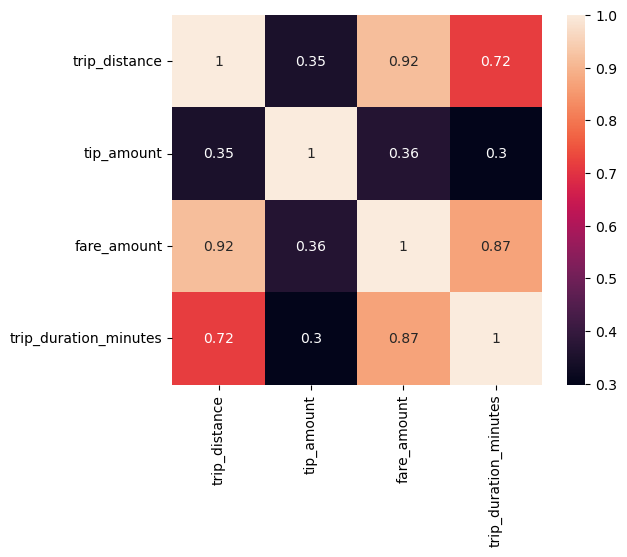

In [33]:
# generate a heatmap to draw correlation between the taxi trip features
sns.heatmap(taxi_data_df.corr(),square=True,annot=True)

In [34]:
# print correlation table
taxi_data_pred_df.corr()

,trip_distance,tip_amount,fare_amount,trip_duration_minutes,prediction
trip_distance,1.000000,0.347394,0.916400,0.717408,0.477533
tip_amount,0.347394,1.000000,0.364633,0.297947,0.247418
fare_amount,0.916400,0.364633,1.000000,0.871040,0.537595
trip_duration_minutes,0.717408,0.297947,0.871040,1.000000,0.509951
prediction,0.477533,0.247418,0.537595,0.509951,1.000000


In [36]:
# print a scatter plot of clusters based on the predicted value of the type of trip
taxi_data_pred_df.hvplot.scatter(x='trip_duration_minutes',y='fare_amount',by='prediction')

:NdOverlay   [prediction]
   :Scatter   [trip_duration_minutes]   (fare_amount)

In [37]:
# use elbow method to find the number of clusters with the optimum inertia value
k = range(1,10)
inertia = []
for i in k:
    model = KMeans(n_clusters=i,random_state=1)
    model.fit(taxi_data_df)
    inertia.append(model.inertia_)

elbow_df = pd.DataFrame({'k':k,'inertia':inertia})
elbow_df.hvplot(x='k',y='inertia')

:Curve   [k]   (inertia)

In [38]:
# incorporate the optimum number of clusters back into the KMeans model and re-generate the clutser data
model = KMeans(n_clusters=4, random_state=1)
model.fit(taxi_data_df)
segments = model.predict(taxi_data_df)
taxi_data_pred_df = taxi_data_df.copy()
taxi_data_pred_df['prediction'] = segments

In [39]:
taxi_data_pred_df.hvplot.scatter(x='trip_duration_minutes',y='fare_amount',by='prediction')

:NdOverlay   [prediction]
   :Scatter   [trip_duration_minutes]   (fare_amount)

In [40]:
# sum the taxi trip data by the hour
green_taxi_tripsh_df = green_taxi_trips_df.groupby(pd.Grouper(key='lpep_pickup_datetime', axis=0, freq='H')).sum()

In [41]:
# verify that the dataframe has no blank values to  impute
green_taxi_tripsh_df.isnull().sum()

RatecodeID               0
PULocationID             0
DOLocationID             0
passenger_count          0
trip_distance            0
fare_amount              0
tip_amount               0
tolls_amount             0
total_amount             0
payment_type             0
trip_type                0
trip_duration_minutes    0
dtype: int64

In [42]:
# create a new DataFrame that holds the hourly rollup of the 2022 green taxi cab data
green_taxi_tripsh_2022_df = green_taxi_tripsh_df.loc['2022']

In [43]:
green_taxi_tripsh_2022_df

,RatecodeID,PULocationID,DOLocationID,passenger_count,trip_distance,fare_amount,tip_amount,tolls_amount,total_amount,payment_type,trip_type,trip_duration_minutes
lpep_pickup_datetime,,,,,,,,,,,,
2022-01-01 00:00:00,59.0,6055,7424,72.0,200.43,811.07,107.42,26.20,1047.89,100.0,59.0,2101.0
2022-01-01 01:00:00,64.0,7024,8796,71.0,235.12,973.62,137.08,19.65,1219.90,103.0,61.0,826.0
2022-01-01 02:00:00,60.0,6897,8178,65.0,196.47,805.43,118.95,26.20,1033.13,91.0,56.0,746.0
2022-01-01 03:00:00,39.0,4878,5608,56.0,165.08,607.07,53.83,0.00,713.60,68.0,39.0,556.0
2022-01-01 04:00:00,24.0,2119,2798,25.0,76.16,299.41,45.42,6.55,383.38,31.0,20.0,252.0
...,...,...,...,...,...,...,...,...,...,...,...,...
2022-12-31 19:00:00,153.0,13929,19450,187.0,463.57,2596.13,344.84,29.20,3272.12,231.0,149.0,2135.0
2022-12-31 20:00:00,153.0,16030,19584,168.0,506.62,2710.73,340.23,35.75,3484.91,237.0,149.0,2099.0
2022-12-31 21:00:00,154.0,16120,20437,176.0,467.85,2607.58,372.34,16.10,3384.22,252.0,154.0,2085.0


In [44]:
# using the Prophet module, predict the taxi tip amount (paid either via card or via cash)
from prophet import Prophet

In [45]:
# Prophet DataFrame supports a datetime and a numerical feature columns
prophet_df = green_taxi_tripsh_2022_df['tip_amount']

In [46]:
# verify the DataFrame
prophet_df

lpep_pickup_datetime
2022-01-01 00:00:00    107.42
2022-01-01 01:00:00    137.08
2022-01-01 02:00:00    118.95
2022-01-01 03:00:00     53.83
2022-01-01 04:00:00     45.42
                        ...  
2022-12-31 19:00:00    344.84
2022-12-31 20:00:00    340.23
2022-12-31 21:00:00    372.34
2022-12-31 22:00:00    271.03
2022-12-31 23:00:00    121.12
Freq: H, Name: tip_amount, Length: 8760, dtype: float64

In [39]:
prophet_df.describe()

count    8760.000000
mean      136.700426
std        95.831969
min         0.000000
25%        44.347500
50%       142.445000
75%       208.405000
max       586.580000
Name: tip_amount, dtype: float64

In [47]:
# drop the index of the prophet DataFrame
prophet_df = prophet_df.reset_index()

In [48]:
# verify that there are no missing values
prophet_df.isnull().sum()

lpep_pickup_datetime    0
tip_amount              0
dtype: int64

In [42]:
prophet_df.head()

,lpep_pickup_datetime,tip_amount
0,2022-01-01 00:00:00,55.44
1,2022-01-01 01:00:00,57.75
2,2022-01-01 02:00:00,59.49
3,2022-01-01 03:00:00,25.71
4,2022-01-01 04:00:00,24.03


In [49]:
# rename the columns of the DataFrame as ds and y
prophet_df.columns = ['ds','y']

In [44]:
prophet_df

,ds,y
0,2022-01-01 00:00:00,55.44
1,2022-01-01 01:00:00,57.75
2,2022-01-01 02:00:00,59.49
3,2022-01-01 03:00:00,25.71
4,2022-01-01 04:00:00,24.03
...,...,...
8755,2022-12-31 19:00:00,229.17
8756,2022-12-31 20:00:00,192.36
8757,2022-12-31 21:00:00,183.65
8758,2022-12-31 22:00:00,153.76


In [50]:
# initialize a Prophet model
model_p = Prophet()
display(model_p)

In [51]:
# train the model
model_p.fit(prophet_df)

23:25:02 - cmdstanpy - INFO - Chain [1] start processing
23:25:03 - cmdstanpy - INFO - Chain [1] done processing


In [52]:
# generate future prediction datetime values. for this analysis, the prediction is 30 days out
future_df = model_p.make_future_dataframe(24*30,freq='H')

In [53]:
# review dataframe generated by the make_future_predictions data frame
future_df.shape

(9480, 1)

In [54]:
# call the predict funtion on the model to predict the tip amounts one month forward
forecast = model_p.predict(future_df)

In [50]:
display(forecast.shape)

(9480, 19)

In [55]:
# review the forecast df, generated out of prediction
forecast.head()

,ds,trend,yhat_lower,yhat_upper,trend_lower,trend_upper,additive_terms,additive_terms_lower,additive_terms_upper,daily,daily_lower,daily_upper,weekly,weekly_lower,weekly_upper,multiplicative_terms,multiplicative_terms_lower,multiplicative_terms_upper,yhat
0,2022-01-01 00:00:00,119.628007,-42.749785,100.069848,119.628007,119.628007,-89.057474,-89.057474,-89.057474,-99.073922,-99.073922,-99.073922,10.016448,10.016448,10.016448,0.0,0.0,0.0,30.570533
1,2022-01-01 01:00:00,119.673056,-55.891182,72.759151,119.673056,119.673056,-113.808904,-113.808904,-113.808904,-122.974310,-122.974310,-122.974310,9.165406,9.165406,9.165406,0.0,0.0,0.0,5.864153
2,2022-01-01 02:00:00,119.718106,-82.235662,52.107429,119.718106,119.718106,-139.807471,-139.807471,-139.807471,-148.066110,-148.066110,-148.066110,8.258639,8.258639,8.258639,0.0,0.0,0.0,-20.089365
3,2022-01-01 03:00:00,119.763156,-105.939081,24.962428,119.763156,119.763156,-158.328849,-158.328849,-158.328849,-165.625477,-165.625477,-165.625477,7.296628,7.296628,7.296628,0.0,0.0,0.0,-38.565694
4,2022-01-01 04:00:00,119.808205,-105.483117,31.026157,119.808205,119.808205,-157.459587,-157.459587,-157.459587,-163.739917,-163.739917,-163.739917,6.280331,6.280331,6.280331,0.0,0.0,0.0,-37.651381


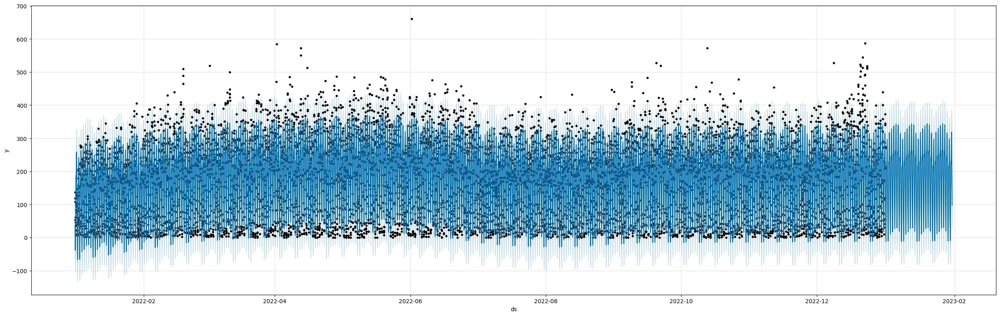

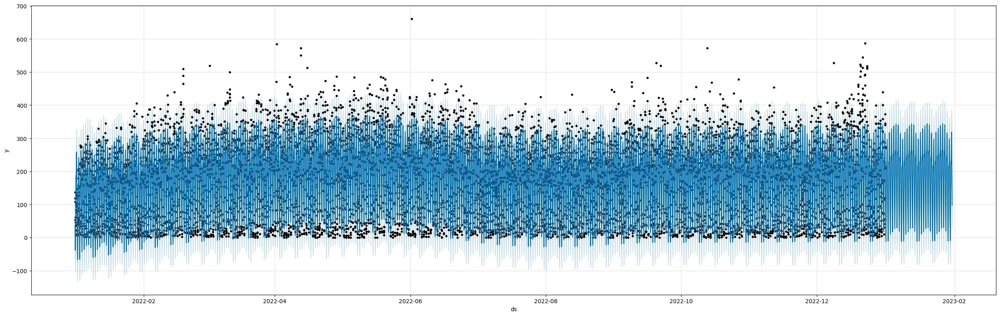

In [56]:
# plot the model
model_p.plot(forecast,figsize=(25,8))

In [53]:
forecast = forecast.set_index('ds')

In [57]:
# print a plot showing yhat, yhat_lower (worst possible scenario) and yhat_upper (best possible scenario)
forecast[['yhat','yhat_lower','yhat_upper']].iloc[-360:,:].hvplot()

:NdOverlay   [Variable]
   :Curve   [index]   (value)

In [58]:
forecast = forecast.reset_index()

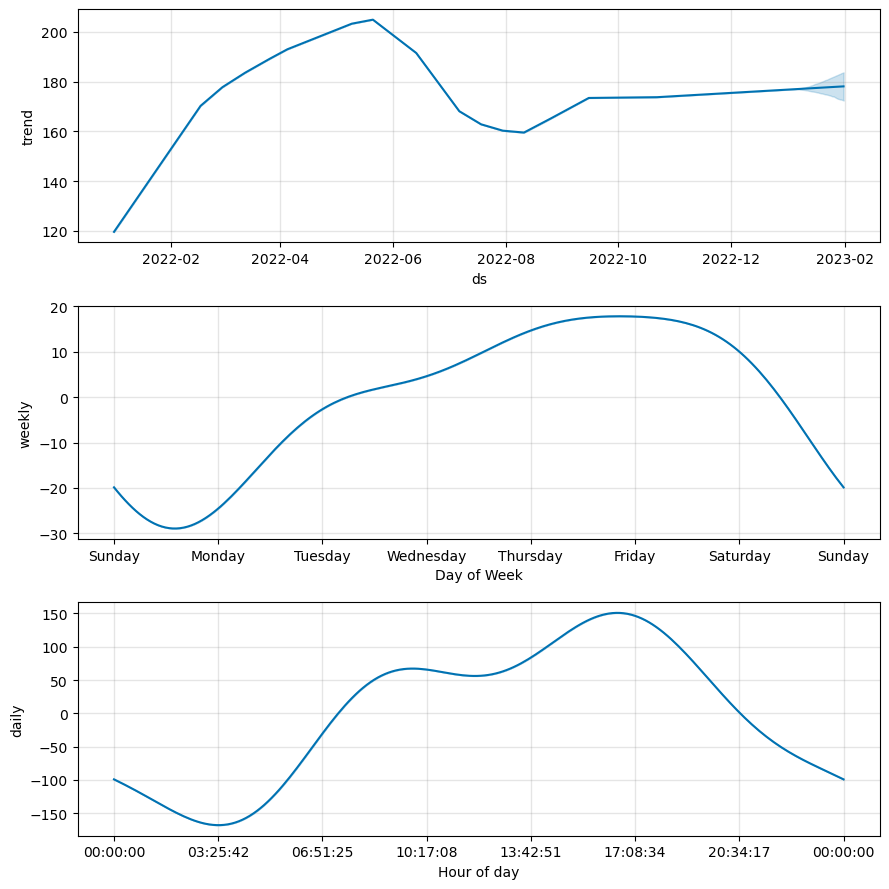

In [59]:
# plot components provide an insight of the predictions
fig2 = model_p.plot_components(forecast)

In [57]:
#from sklearn import preprocessing

In [58]:
# green_taxi_2022_hourly_df = green_taxi_tripsh_2022_df[['passenger_count',
#                                                        'trip_distance',
#                                                        'trip_duration_minutes',
#                                                        'fare_amount',
#                                                        'tolls_amount',
#                                                        'total_amount',
#                                                        'payment_type',
#                                                        'trip_type',
#                                                        'tip_amount']]

In [59]:
# green_taxi_2022_hourly_df = green_taxi_2022_hourly_df.reset_index()

In [60]:
# green_taxi_2022_hourly_df.drop(columns=['lpep_pickup_datetime'], inplace=True)

In [61]:
# green_taxi_2022_hourly_df.tail()

,passenger_count,trip_distance,trip_duration_minutes,fare_amount,tolls_amount,total_amount,payment_type,trip_type,tip_amount
8755,87.0,197.12,977.0,1103.0,6.55,1512.37,67.0,67.0,229.17
8756,69.0,214.02,806.0,1092.6,13.10,1510.16,61.0,61.0,192.36
8757,65.0,153.51,614.0,791.4,3.00,1146.50,56.0,56.0,183.65
8758,59.0,161.39,624.0,825.1,0.00,1114.76,47.0,47.0,153.76
8759,30.0,73.22,297.0,396.2,0.00,568.93,26.0,26.0,83.48


In [62]:
# robust_scaler = preprocessing.RobustScaler()
# robust_scaler_df = robust_scaler.fit_transform(green_taxi_2022_hourly_df)

In [63]:
# robust_scaler_df = pd.DataFrame(robust_scaler_df, columns=green_taxi_2022_hourly_df.columns)
# robust_scaler_df

,passenger_count,trip_distance,trip_duration_minutes,fare_amount,tolls_amount,total_amount,payment_type,trip_type,tip_amount
0,-0.600000,-0.514091,-0.469964,-0.520820,-0.500000,-0.520302,-0.578947,-0.578947,-0.530332
1,-0.586667,-0.550231,-0.478649,-0.518176,-0.500000,-0.525417,-0.561404,-0.561404,-0.516252
2,-0.493333,-0.574040,-0.488299,-0.548579,0.000000,-0.529080,-0.526316,-0.526316,-0.505646
3,-0.613333,-0.700073,-0.579976,-0.678123,-0.500000,-0.684351,-0.719298,-0.719298,-0.711549
4,-0.760000,-0.764638,-0.588661,-0.715135,0.000000,-0.710143,-0.736842,-0.736842,-0.721790
...,...,...,...,...,...,...,...,...,...
8755,0.280000,0.251579,0.234499,0.589557,0.000000,0.569561,0.280702,0.280702,0.528626
8756,0.040000,0.354227,0.069481,0.575810,0.500000,0.567463,0.175439,0.175439,0.304253
8757,-0.013333,-0.013302,-0.115802,0.177660,-0.270992,0.222379,0.087719,0.087719,0.251162
8758,-0.093333,0.034560,-0.106152,0.222208,-0.500000,0.192261,-0.070175,-0.070175,0.068970


In [64]:
# standard_scaler = preprocessing.StandardScaler()
# standard_scaler_df = standard_scaler.fit_transform(robust_scaler_df)

In [65]:
# standard_scaler_df = pd.DataFrame(standard_scaler_df,columns=robust_scaler_df.columns)

In [66]:
# standard_scaler_df

,passenger_count,trip_distance,trip_duration_minutes,fare_amount,tolls_amount,total_amount,payment_type,trip_type,tip_amount
0,-0.960836,-0.780832,-0.733588,-0.840448,-0.893618,-0.838867,-0.917020,-0.917020,-0.847995
1,-0.937656,-0.843603,-0.743869,-0.835829,-0.893618,-0.847652,-0.886558,-0.886558,-0.823889
2,-0.775391,-0.884958,-0.755292,-0.888938,-0.284054,-0.853944,-0.825633,-0.825633,-0.805731
3,-0.984017,-1.103864,-0.863814,-1.115229,-0.893618,-1.120657,-1.160720,-1.160720,-1.158244
4,-1.239003,-1.216008,-0.874095,-1.179884,-0.284054,-1.164960,-1.191182,-1.191182,-1.175775
...,...,...,...,...,...,...,...,...,...
8755,0.569084,0.549065,0.100316,1.099188,-0.284054,1.033209,0.575639,0.575639,0.964969
8756,0.151833,0.727355,-0.095023,1.075174,0.325509,1.029607,0.392865,0.392865,0.580837
8757,0.059111,0.088992,-0.314351,0.379676,-0.614428,0.436850,0.240552,0.240552,0.489944
8758,-0.079973,0.172124,-0.302928,0.457492,-0.893618,0.385114,-0.033610,-0.033610,0.178026


In [67]:
#from sklearn.model_selection import train_test_split

In [68]:
# y = standard_scaler_df['tip_amount']
# X = standard_scaler_df.drop(columns=['tip_amount']).copy()

In [83]:
# X.tail()

,passenger_count,trip_distance,trip_duration_minutes,fare_amount,tolls_amount,total_amount,payment_type,trip_type
8755,87.0,197.12,977.0,1103.0,6.55,1512.37,67.0,67.0
8756,69.0,214.02,806.0,1092.6,13.10,1510.16,61.0,61.0
8757,65.0,153.51,614.0,791.4,3.00,1146.50,56.0,56.0
8758,59.0,161.39,624.0,825.1,0.00,1114.76,47.0,47.0
8759,30.0,73.22,297.0,396.2,0.00,568.93,26.0,26.0


In [70]:
# y

0      -0.847995
1      -0.823889
2      -0.805731
3      -1.158244
4      -1.175775
          ...   
8755    0.964969
8756    0.580837
8757    0.489944
8758    0.178026
8759   -0.555383
Name: tip_amount, Length: 8760, dtype: float64

In [71]:
#X_train, X_test, y_train, y_test = train_test_split(X,y,test_size=0.33, random_state=1)

### Create a Linear Regression Model to predict the tips the Taxi Cab drivers will receive

In [61]:
import numpy as np
from sklearn.linear_model import LinearRegression
from sklearn.model_selection import train_test_split
import sklearn.metrics as met

In [63]:
X = green_taxi_tripsh_2022_df.drop(columns=['tip_amount']).copy()
y = green_taxi_tripsh_2022_df['tip_amount'].copy()

In [64]:
# initialize the Linear Regression Model
model_lr = LinearRegression()

In [65]:
# split training and test dataset
X_train,X_test,y_train,y_test = train_test_split(X,y,random_state=1)

In [67]:
display(X_train.shape)

(6570, 11)

In [77]:
display(X_test.shape)

(2190, 8)

In [68]:
model_lr.fit(X_train, y_train)

LinearRegression()

In [69]:
# make predictions by the predict model
y_pred = model_lr.predict(X_test)
display(y_pred.shape)

(2190,)

In [70]:
X_test['pred_tip_amount'] = y_pred
X_test['actual_tip_amount'] = y_test

In [71]:
display(met.r2_score(y_test, y_pred))

0.9726525402974362

## Observations
* The Linear Regression Model has a r2 score of 0.972 which is very reliable score